# Overcooked-AI: Generalization Evaluation Notebook

This notebook evaluates a PPO agent trained for generalization across multiple layouts in the Overcooked-AI environment.  
We report average performance on three different layouts using both **greedy** (always selecting the most probable action) and **sampling** (actions sampled from the policy) evaluation.  
For each layout, a gameplay GIF is shown to visually illustrate agent behavior.

---


In [1]:
# --- Imports and Setup ---
import tensorflow as tf
import numpy as np
import os
from IPython.display import display, Image

from env.generalized_env import GeneralizedOvercooked
from agents.ppo_tf import PPOAgent
from training.evaluate_selfplay import evaluate_policy

# --- Utility to display GIFs in the notebook ---
def show_gif(gif_path):
    if os.path.exists(gif_path):
        display(Image(filename=gif_path))
    else:
        print(f"GIF not found: {gif_path}")


2025-06-05 18:40:42.864576: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-06-05 18:40:42.873080: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749141642.883550    7113 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749141642.886597    7113 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1749141642.894397    7113 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

## 0. Testing the training on single layout cramped_room 
Testing the model trained only in cramped_room in greedy mode.
Saves and displays the gif of the episode. 

In [2]:
results_greedy_cramped_room = []

policy_weights_cramped_room = "cramped_room/checkpoints/policy_PPO_deep_shaping-decay-15000new_setup_15000_full_log_2_final.weights.h5"
value_weights_cramped_room  = "cramped_room/checkpoints/value_PPO_deep_shaping-decay-15000new_setup_15000_full_log_2_final.weights.h5"

# Create environment and agent for this layout
env = GeneralizedOvercooked(["cramped_room"])
obs_dim = env.observation_space.shape[0]
act_dim = env.action_space.n

agent = PPOAgent(obs_dim, act_dim, arch_variant='deep', use_reward_shaping=True, use_decay=True)

# Dummy forward pass to initialize model weights
agent.policy(tf.random.uniform((1, obs_dim)))
agent.value(tf.random.uniform((1, obs_dim)))

# Load trained weights
agent.policy.load_weights(policy_weights_cramped_room)
agent.value.load_weights(value_weights_cramped_room)

# Evaluate policy in greedy mode and save GIF for this layout
gif_path = f"demo/cramped_room/cramped_room_eval_greedy.gif"
reward = evaluate_policy(
    agent, env, greedy=True, save_gif=True, gif_path=gif_path
)
results_greedy_cramped_room.append(("cramped_room", reward, gif_path))
print(f"Greedy reward on cramped_room: {reward:.2f}")



2025-06-05 18:26:00.612688: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)



Initialized PPO agent with architecture: deep
obs_dim=96, act_dim=6, gamma=0.99, clip_ratio=0.15, lr=0.0005
use_reward_shaping=True, use_decay=True
GIF saved at: demo/cramped_room/cramped_room_eval_greedy.gif
[Eval] Total reward: 200.00 | Steps: 400 | Done: True
Greedy reward on cramped_room: 200.00



===== Greedy Evaluation Results =====
Layout                    |   Reward
------------------------------------
cramped_room              |   200.00

=== Greedy Evaluation GIFs ===
Layout: cramped_room


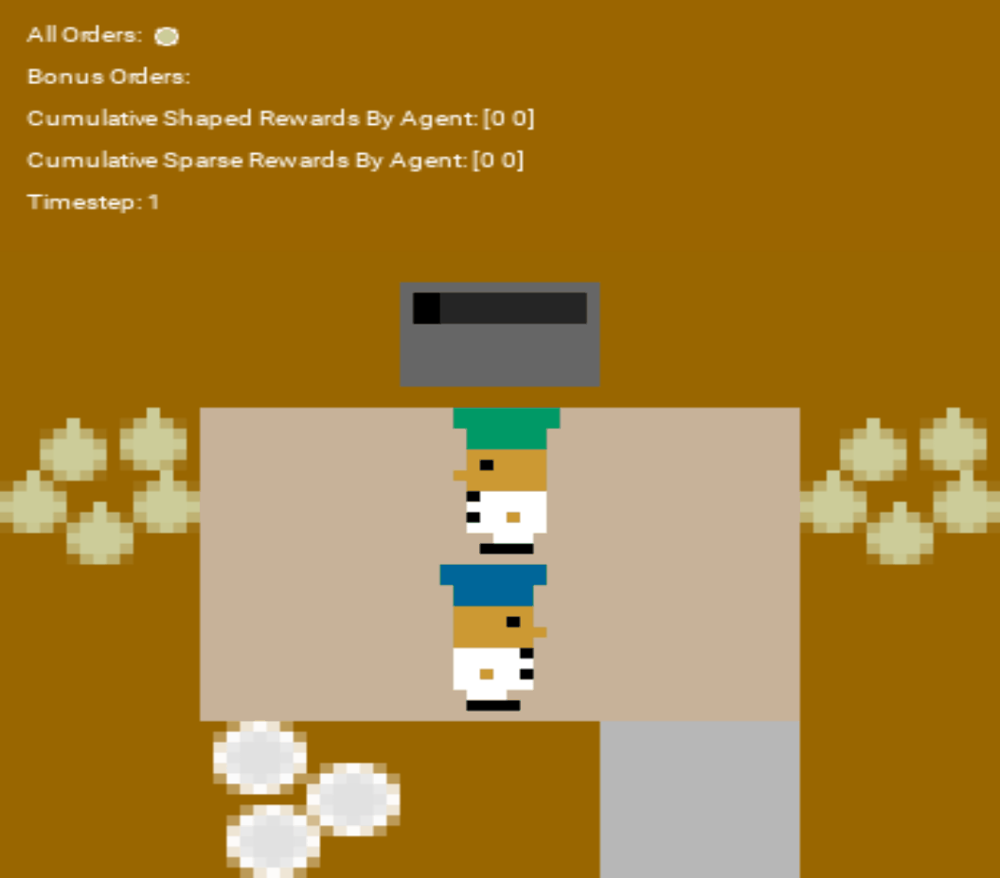

In [3]:
# --- Show results and GIFs for greedy evaluation ---
print("\n===== Greedy Evaluation Results =====")
print("{:<25} | {:>8}".format("Layout", "Reward"))
print("-" * 36)
print("{:<25} | {:>8.2f}".format("cramped_room", reward))

print("\n=== Greedy Evaluation GIFs ===")
print("Layout: cramped_room")
show_gif(gif_path)

## 1. Generalization experiment: Greedy Evaluation

Evaluate the agent by always selecting the action with the highest probability (greedy policy).  
For each layout, the total reward achieved in one run is shown and a GIF of the episode is displayed.

Note: There is a big overhead for gif saving, expect 3-4 minutes for compute the following cell. 


In [2]:
# --- Layouts to evaluate for generalization ---
test_layouts = [
    "cramped_room",
    "asymmetric_advantages",
    "forced_coordination",
]

# --- Trained policy weights (update with your actual checkpoint paths) ---
policy_weights = "generalization/multilayout_checkpoints/policy_PPO_deep_shaping-decay-20000multilayout_run_20000_final.weights.h5"
value_weights  = "generalization/multilayout_checkpoints/value_PPO_deep_shaping-decay-20000multilayout_run_20000_final.weights.h5"

results_greedy = []

for layout in test_layouts:
    print(f"\n[Greedy Eval] Layout: {layout}")

    # Create environment and agent for this layout
    env = GeneralizedOvercooked([layout])
    obs_dim = env.observation_space.shape[0]
    act_dim = env.action_space.n

    agent = PPOAgent(obs_dim, act_dim, arch_variant='deep', use_reward_shaping=True, use_decay=True)

    # Dummy forward pass to initialize model weights
    agent.policy(tf.random.uniform((1, obs_dim)))
    agent.value(tf.random.uniform((1, obs_dim)))

    # Load trained weights
    agent.policy.load_weights(policy_weights)
    agent.value.load_weights(value_weights)

    # Evaluate policy in greedy mode and save GIF for this layout
    gif_path = f"demo/generalization/{layout}_eval_greedy.gif"
    reward = evaluate_policy(
        agent, env, greedy=True, save_gif=True, gif_path=gif_path
    )
    results_greedy.append((layout, reward, gif_path))
    print(f"Greedy reward on {layout}: {reward:.2f}")



[Greedy Eval] Layout: cramped_room

Initialized PPO agent with architecture: deep
obs_dim=96, act_dim=6, gamma=0.99, clip_ratio=0.15, lr=0.0005
use_reward_shaping=True, use_decay=True


2025-06-05 18:40:48.738381: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


GIF saved at: demo/generalization/cramped_room_eval_greedy.gif
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
Greedy reward on cramped_room: 180.00

[Greedy Eval] Layout: asymmetric_advantages

Initialized PPO agent with architecture: deep
obs_dim=96, act_dim=6, gamma=0.99, clip_ratio=0.15, lr=0.0005
use_reward_shaping=True, use_decay=True
GIF saved at: demo/generalization/asymmetric_advantages_eval_greedy.gif
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
Greedy reward on asymmetric_advantages: 180.00

[Greedy Eval] Layout: forced_coordination

Initialized PPO agent with architecture: deep
obs_dim=96, act_dim=6, gamma=0.99, clip_ratio=0.15, lr=0.0005
use_reward_shaping=True, use_decay=True
GIF saved at: demo/generalization/forced_coordination_eval_greedy.gif
[Eval] Total reward: 0.00 | Steps: 400 | Done: True
Greedy reward on forced_coordination: 0.00



===== Greedy Evaluation Results =====
Layout                    |   Reward
------------------------------------
cramped_room              |   180.00
asymmetric_advantages     |   180.00
forced_coordination       |     0.00

=== Greedy Evaluation GIFs ===
Layout: cramped_room


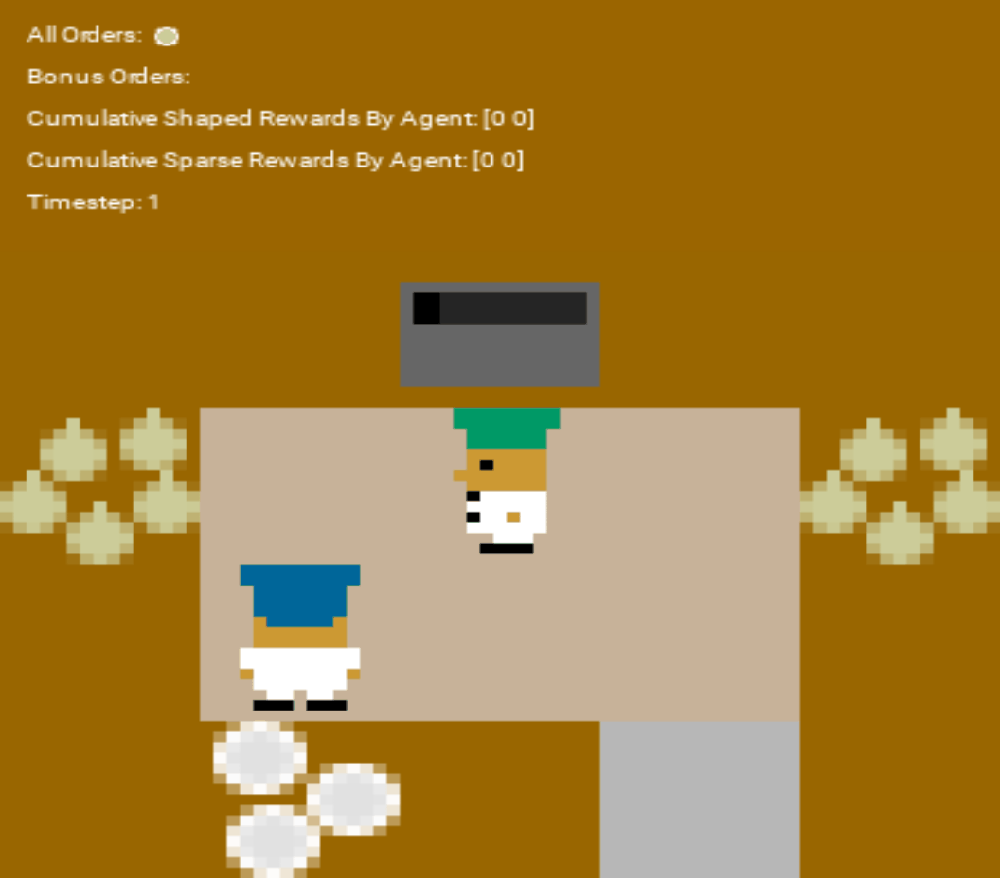

Layout: cramped_room


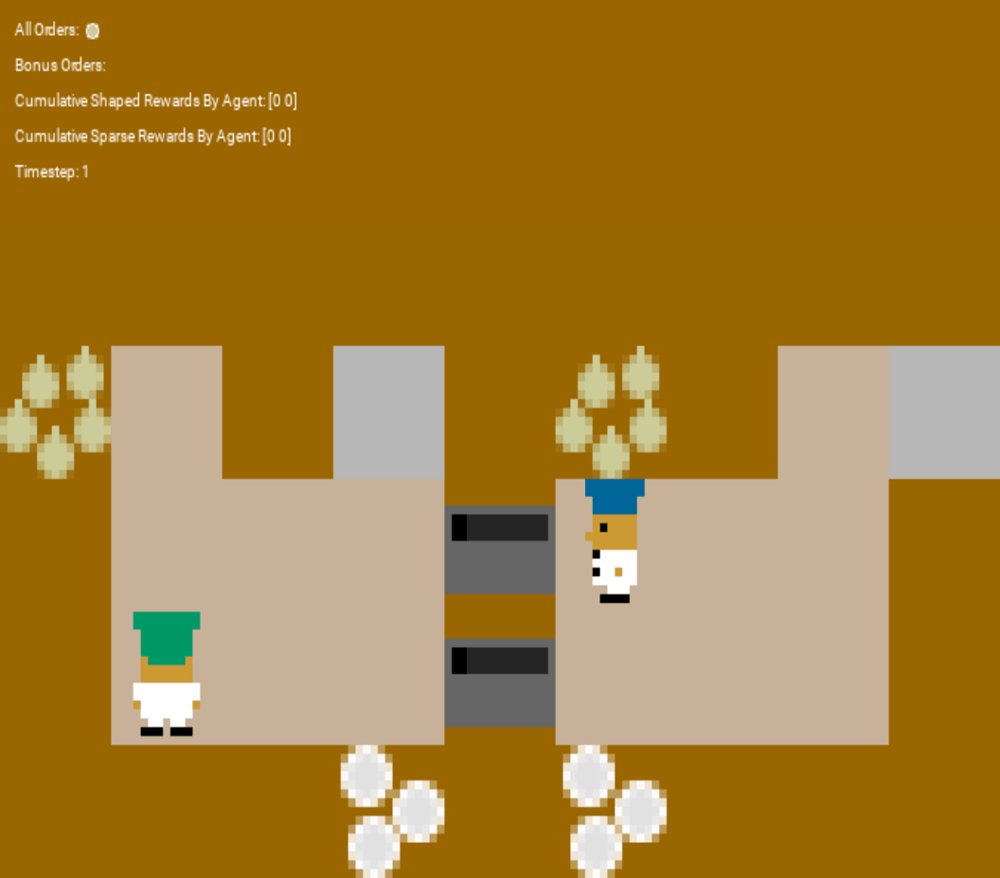

Layout: cramped_room


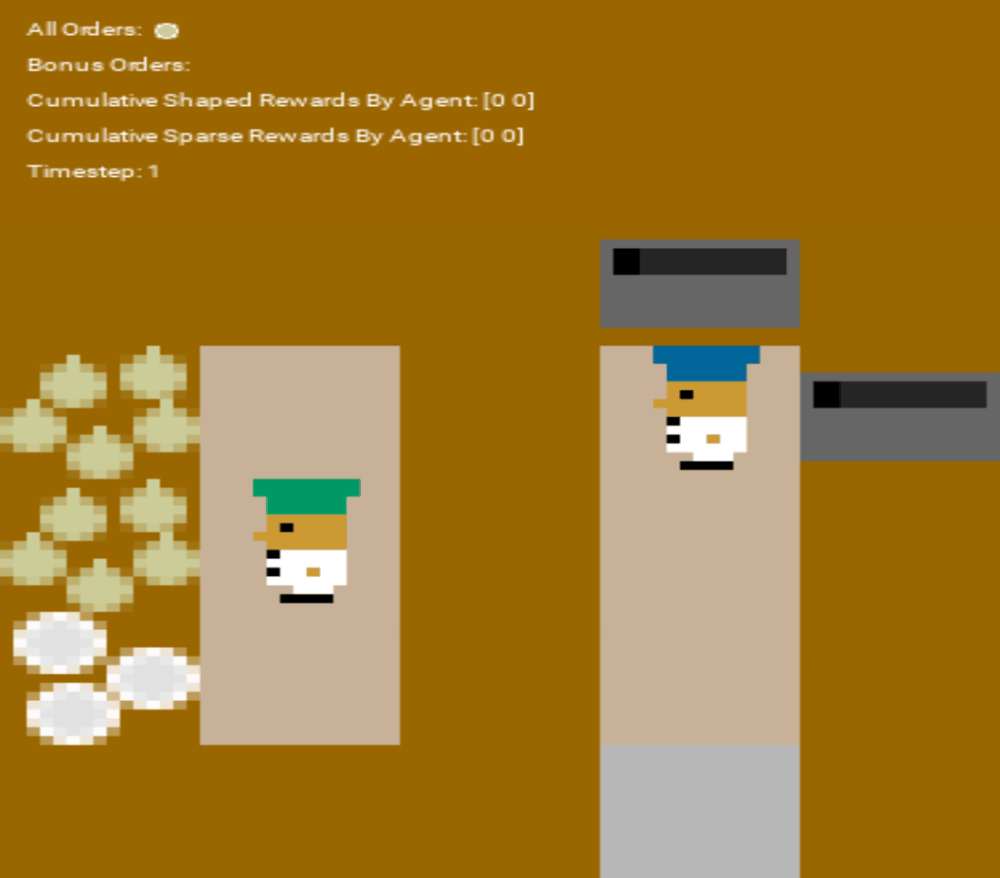

In [3]:
# --- Show results and GIFs for greedy evaluation ---
print("\n===== Greedy Evaluation Results =====")
print("{:<25} | {:>8}".format("Layout", "Reward"))
print("-" * 36)
for layout, reward, _ in results_greedy:
    print("{:<25} | {:>8.2f}".format(layout, reward))
    
print("\n=== Greedy Evaluation GIFs ===")
for layout, _, gif_path in results_greedy:
    print(f"Layout: cramped_room")
    show_gif(gif_path)

## 2. Sampling Evaluation

Evaluate the agent with stochastic policy (actions are sampled from the policy distribution).  
For each layout, average and standard deviation of total rewards over multiple runs are reported.  
A GIF of the first sampled run is also shown for qualitative analysis.


In [ ]:
N_RUNS = 10  # Number of sampling episodes per layout
results_sampling = []

for layout in test_layouts:
    print(f"\n[Sampling Eval] Layout: {layout}")

    # Setup environment and agent for this layout
    env = GeneralizedOvercooked([layout])
    obs_dim = env.observation_space.shape[0]
    act_dim = env.action_space.n

    agent = PPOAgent(obs_dim, act_dim, arch_variant='deep', use_reward_shaping=True, use_decay=True)
    agent.policy(tf.random.uniform((1, obs_dim)))
    agent.value(tf.random.uniform((1, obs_dim)))
    agent.policy.load_weights(policy_weights)
    agent.value.load_weights(value_weights)

    rewards = []
    for i in range(N_RUNS):
        # Only save a gif for the first sampled run
        gif_path = f"demo/generalization/{layout}_eval_sampling.gif" if i == 0 else None
        reward = evaluate_policy(
            agent, env, greedy=False, save_gif=(i == 0), gif_path=gif_path
        )
        rewards.append(reward)
    mean_reward = np.mean(rewards)
    std_reward = np.std(rewards)
    results_sampling.append((layout, mean_reward, std_reward, f"generalization/{layout}/eval_sampling.gif"))
    print(f"Sampling eval on {layout}: mean={mean_reward:.2f} ± {std_reward:.2f}")




[Sampling Eval] Layout: cramped_room

Initialized PPO agent with architecture: deep
obs_dim=96, act_dim=6, gamma=0.99, clip_ratio=0.15, lr=0.0005
use_reward_shaping=True, use_decay=True
GIF saved at: demo/generalization/cramped_room_eval_sampling.gif
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
[Eval] Total reward: 180.00 | Steps: 400 | Done: True
Sampling eval on cramped_room: mean=180.00 ± 0.00

[Sampling Eval] Layout: asymmetric_advantages

Initialized PPO agent with architecture: deep
obs_dim=96, act_dim=6, gamma=0.99, clip_ratio=0.15, lr=0.0005
us

In [ ]:
# --- Show results and GIFs for sampling evaluation ---
print("\n===== Sampling Evaluation Results =====")
print("{:<25} | {:>8} | {:>8}".format("Layout", "Mean", "Std"))
print("-" * 46)
for layout, mean, std, _ in results_sampling:
    print("{:<25} | {:>8.2f} | {:>8.2f}".format(layout, mean, std))

print("\n=== Sampling Evaluation GIFs ===")
for layout, _, _, gif_path in results_sampling:
    print(f"Layout: {layout}")
    show_gif(gif_path)